In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
import torchvision.utils as vutils
import matplotlib.animation as animation
from IPython.display import HTML

import PIL
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
from PIL import Image
import numpy as np
import pandas as pd
import copy
import time
import cv2 as cv
from tqdm import tqdm_notebook as tqdm
import matplotlib.image as mpimg

import torchvision.transforms.functional as TF

In [4]:
anime = '/content/drive/MyDrive/Images/animation/'
astro = '/content/drive/MyDrive/Images/astro/'
geo = '/content/drive/MyDrive/Images/geo/'
scenary = '/content/drive/MyDrive/Images/scenary/'

valid_ratio = 0.1
num_images_to_show = 5
device = 'cuda'

In [5]:
class ImageData(Dataset):
    def __init__(self,is_train=True):
        self.is_train = is_train
        self.transform = transforms.Compose([transforms.ToTensor(),])
        self.train_index = int(valid_ratio * len(img_list))
        self.crop = transforms.CenterCrop((218,178))
    def __len__(self):
        if self.is_train:
            return self.train_index
        else:
            return len(img_list) - self.train_index -1
    def __getitem__(self, index):
        if not self.is_train:
            index = self.train_index + index
        img = mpimg.imread(img_dir+img_list[index])
        img = self.crop(TF.to_pil_image(img))
        img = self.transform(img)
        img = (img-0.5) /0.5
#         img = (img - 255.0) / 255.0

        return img

In [6]:
img_dir = anime
img_list = os.listdir(img_dir)
print(len(img_list))
valid_dataset = ImageData(is_train=False)
batch_size = num_images_to_show
valid_dataloader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=True)
anime_batch = next(iter(valid_dataloader)).to(device)

13


In [7]:
img_dir = astro
img_list = os.listdir(img_dir)
print(len(img_list))
valid_dataset = ImageData(is_train=False)
batch_size = num_images_to_show
valid_dataloader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=True)
astro_batch = next(iter(valid_dataloader)).to(device)

10


In [8]:
img_dir = scenary
img_list = os.listdir(img_dir)
print(len(img_list))
valid_dataset = ImageData(is_train=False)
batch_size = num_images_to_show
valid_dataloader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=True)
scenary_batch = next(iter(valid_dataloader)).to(device)

7


In [9]:
img_dir = geo
img_list = os.listdir(img_dir)
print(len(img_list))
valid_dataset = ImageData(is_train=False)
batch_size = num_images_to_show
valid_dataloader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=True)
geo_batch = next(iter(valid_dataloader)).to(device)

9


In [10]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [11]:
IMG_WIDTH = 178
IMG_HEIGHT = 218
latent_size = 200

In [12]:
# Encoder Model
class Encoder(nn.Module):
    def __init__(self,num_channels_in_encoder):
        super(Encoder, self).__init__()
        
        # ENCODER

        # 64x64x64
        self.e_conv_1 = nn.Sequential(
            nn.ZeroPad2d((1, 2, 1, 2)),
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(5, 5), stride=(2, 2)),nn.LeakyReLU()
        )

        # 128x32x32
        self.e_conv_2 = nn.Sequential(
            nn.ZeroPad2d((1, 2, 1, 2)),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(5, 5), stride=(2, 2)),
            nn.LeakyReLU()
        )
        
        # 128x32x32
        self.e_block_1 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x32x32
        self.e_block_2 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x32x32
        self.e_block_3 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 32x32x32
        self.e_conv_3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=num_channels_in_encoder, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2)),
            nn.Tanh()
        )
    def forward(self, x):
        ec1 = self.e_conv_1(x)
        ec2 = self.e_conv_2(ec1)
        eblock1 = self.e_block_1(ec2) + ec2
        eblock2 = self.e_block_2(eblock1) + eblock1
        eblock3 = self.e_block_3(eblock2) + eblock2
        ec3 = self.e_conv_3(eblock3)  # in [-1, 1] from tanh activation
        return ec3

In [13]:
device

'cuda'

In [14]:
# Generator / Decoder Model

class Generator(nn.Module):
    def __init__(self,num_channels_in_encoder):
        super(Generator, self).__init__()
        
        # DECODER
#         self.latent_fc1 = nn.Sequential(
#             nn.Linear(latent_size,1000),
#             nn.Sigmoid(),
#         )
#         self.latent_fc2 = nn.Sequential(
#             nn.Linear(1000,54*44),
#             nn.Sigmoid(),
#         )
        # 128x64x64
        self.d_up_conv_1 = nn.Sequential(
        nn.Conv2d(in_channels=num_channels_in_encoder, out_channels=64, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.ConvTranspose2d(in_channels=64, out_channels=128, kernel_size=(2, 2), stride=(2, 2))
        )

        # 128x64x64
        self.d_block_1 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x64x64
        self.d_block_2 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x64x64
        self.d_block_3 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 256x128x128
        self.d_up_conv_2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=32, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.ConvTranspose2d(in_channels=32, out_channels=128, kernel_size=(2, 2), stride=(2, 2))
        )

        # 3x128x128
        self.d_up_conv_3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=16, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(in_channels=16, out_channels=3, kernel_size=(3, 3), stride=(1, 1)),
            nn.Tanh()
        )

        
        
    def forward(self, x):
        uc1 = self.d_up_conv_1(x)
        dblock1 = self.d_block_1(uc1) + uc1
        dblock2 = self.d_block_2(dblock1) + dblock1
        dblock3 = self.d_block_3(dblock2) + dblock2
        uc2 = self.d_up_conv_2(dblock3)
        dec = self.d_up_conv_3(uc2)
        return dec

In [15]:
num_channels_in_encoder = 40
netG40 = Generator(num_channels_in_encoder).to(device)
netG40.apply(weights_init)

num_channels_in_encoder = 40
netE40 = Encoder(num_channels_in_encoder).to(device)
netE40.apply(weights_init)

netG40.load_state_dict(torch.load("/content/netG40.model"))
netE40.load_state_dict(torch.load("/content/netE40.model"))


netE40.eval()
netG40.eval()
output = netE40(anime_batch)
print(output.shape)
print("Compressed Image Size is: "+str((output.shape[1]*output.shape[2]*output.shape[3])/(anime_batch.shape[1]*anime_batch.shape[2]*anime_batch.shape[3]))+" times the original image")

anime_40 = netG40(netE40(anime_batch))
astro_40 = netG40(netE40(astro_batch))
geo_40 = netG40(netE40(geo_batch))
scenary_40 = netG40(netE40(scenary_batch))

del netE40
del netG40
torch.cuda.empty_cache()

torch.Size([5, 40, 54, 44])
Compressed Image Size is: 0.8164106793114112 times the original image


In [16]:
num_channels_in_encoder = 28
netE28 = Encoder(num_channels_in_encoder).to(device)
netE28.apply(weights_init)

num_channels_in_encoder = 28
netG28 = Generator(num_channels_in_encoder).to(device)
netG28.apply(weights_init)

netG28.load_state_dict(torch.load("/content/netG28.model"))
netE28.load_state_dict(torch.load("/content/netE28.model"))


netE28.eval()
netG28.eval()

output = netE28(anime_batch)
print(output.shape)
print("Compressed Image Size is: "+str((output.shape[1]*output.shape[2]*output.shape[3])/(anime_batch.shape[1]*anime_batch.shape[2]*anime_batch.shape[3]))+" times the original image")

anime_28 = netG28(netE28(anime_batch))
astro_28 = netG28(netE28(astro_batch))
geo_28 = netG28(netE28(geo_batch))
scenary_28 = netG28(netE28(scenary_batch))

del netE28
del netG28
torch.cuda.empty_cache()

torch.Size([5, 28, 54, 44])
Compressed Image Size is: 0.5714874755179878 times the original image


In [17]:
num_channels_in_encoder = 16
netG16 = Generator(num_channels_in_encoder).to(device)
netG16.apply(weights_init)

num_channels_in_encoder = 16
netE16 = Encoder(num_channels_in_encoder).to(device)
netE16.apply(weights_init)

netG16.load_state_dict(torch.load("/content/netG16.model"))
netE16.load_state_dict(torch.load("/content/netE16.model"))


netE16.eval()
netG16.eval()

output = netE16(anime_batch)
print(output.shape)
print("Compressed Image Size is: "+str((output.shape[1]*output.shape[2]*output.shape[3])/(anime_batch.shape[1]*anime_batch.shape[2]*anime_batch.shape[3]))+" times the original image")

anime_16 = netG16(netE16(anime_batch))
astro_16 = netG16(netE16(astro_batch))
geo_16 = netG16(netE16(geo_batch))
scenary_16 = netG16(netE16(scenary_batch))

del netE16
del netG16
torch.cuda.empty_cache()

torch.Size([5, 16, 54, 44])
Compressed Image Size is: 0.3265642717245645 times the original image


In [18]:
num_channels_in_encoder = 8
netE8 = Encoder(num_channels_in_encoder).to(device)
netE8.apply(weights_init)


netG8 = Generator(num_channels_in_encoder).to(device)
netG8.apply(weights_init)


netG8.load_state_dict(torch.load("/content/netG8.model"))
netE8.load_state_dict(torch.load("/content/netE8.model"))


netG8.eval()
netE8.eval()

output = netE8(anime_batch)
print(output.shape)
print("Compressed Image Size is: "+str((output.shape[1]*output.shape[2]*output.shape[3])/(anime_batch.shape[1]*anime_batch.shape[2]*anime_batch.shape[3]))+" times the original image")

anime_8 = netG8(netE8(anime_batch))
astro_8 = netG8(netE8(astro_batch))
geo_8 = netG8(netE8(geo_batch))
scenary_8 = netG8(netE8(scenary_batch))

del netE8
del netG8
torch.cuda.empty_cache()

torch.Size([5, 8, 54, 44])
Compressed Image Size is: 0.16328213586228224 times the original image


In [19]:
all = [anime_batch[1],astro_batch[1],geo_batch[1],scenary_batch[1]]
all_40 = [anime_40[1],astro_40[1],geo_40[1],scenary_40[1]]
all_28 = [anime_28[1],astro_28[1],geo_28[1],scenary_28[1]]
all_16 = [anime_16[1],astro_16[1],geo_16[1],scenary_16[1]]
all_8 = [anime_8[1],astro_8[1],geo_8[1],scenary_8[1]]

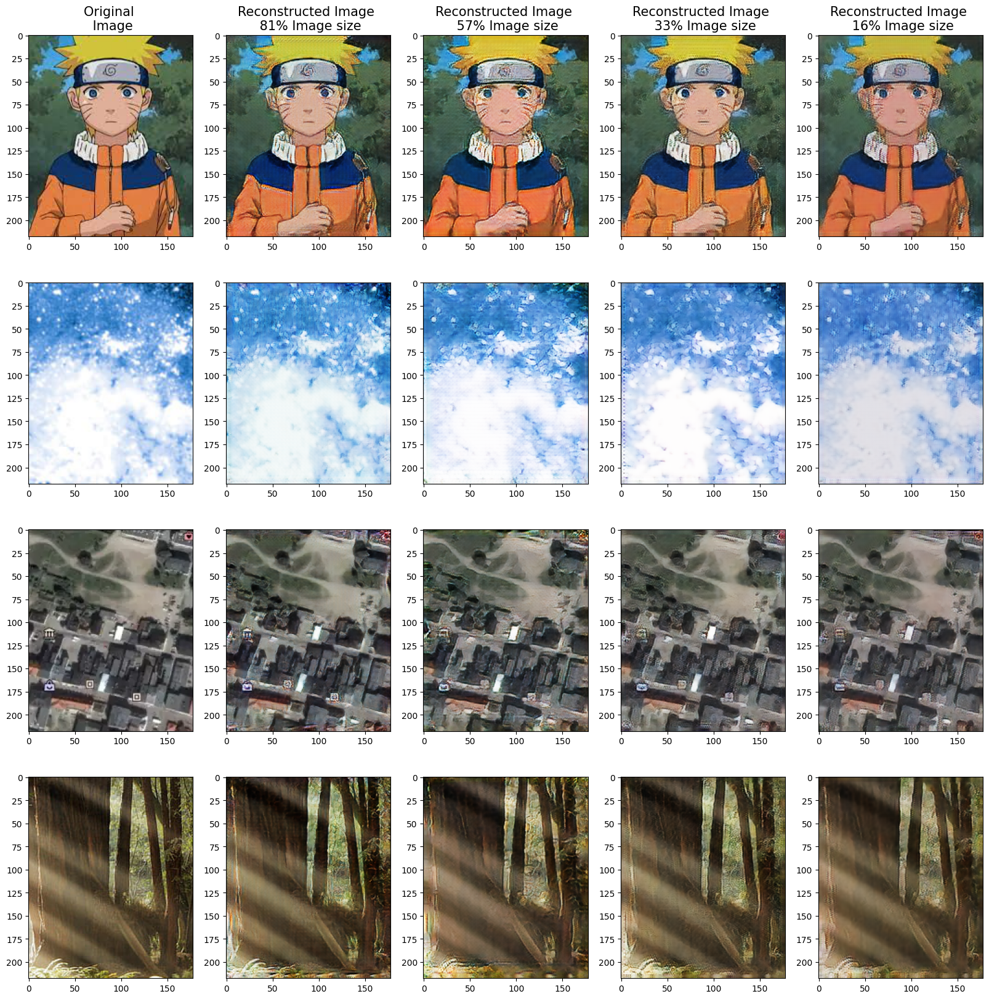

In [20]:

f, axarr = plt.subplots(4,5)

axarr[0,0].title.set_text('Original \n Image')
axarr[0,1].title.set_text('Reconstructed Image \n 81% Image size')
axarr[0,2].title.set_text('Reconstructed Image \n 57% Image size')
axarr[0,3].title.set_text('Reconstructed Image \n 33% Image size')
axarr[0,4].title.set_text('Reconstructed Image \n 16% Image size')

for i in range(5):
    axarr[0,i].title.set_fontsize(15)

for i in range(4):
    axarr[i,0].imshow(all[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,1].imshow(all_40[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,2].imshow(all_28[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,3].imshow(all_16[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,4].imshow(all_8[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    f.set_figheight(20)
    f.set_figwidth(20)
plt.show()

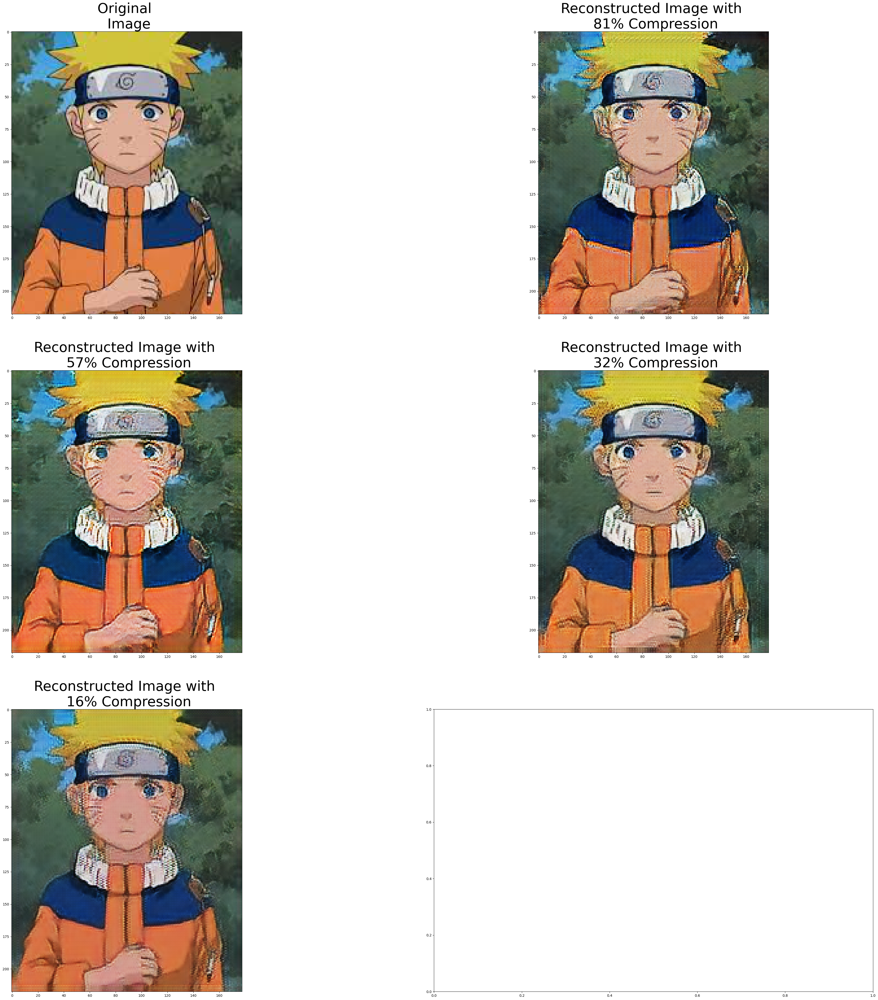

In [21]:
f, axarr = plt.subplots(3,2)

axarr[0,0].title.set_text('Original \n Image')
axarr[0,1].title.set_text('Reconstructed Image with \n 81% Compression')
axarr[1,0].title.set_text('Reconstructed Image with \n 57% Compression')
axarr[1,1].title.set_text('Reconstructed Image with \n 32% Compression')
axarr[2,0].title.set_text('Reconstructed Image with \n 16% Compression')


for i in range(3):
    for j in range(2):
        axarr[i,j].title.set_fontsize(40)
i = 0


reimg = all[i].cpu().detach().permute(1, 2, 0)*0.5+0.5
reimg_40 = all_40[i].cpu().detach().permute(1, 2, 0)*0.5+0.5
reimg_28 = all_28[i].cpu().detach().permute(1, 2, 0)*0.5+0.5
reimg_16 = all_16[i].cpu().detach().permute(1, 2, 0)*0.5+0.5
reimg_8 = all_8[i].cpu().detach().permute(1, 2, 0)*0.5+0.5



axarr[0,0].imshow(reimg)
axarr[0,1].imshow(reimg_40)
axarr[1,0].imshow(reimg_28)
axarr[1,1].imshow(reimg_16)
axarr[2,0].imshow(reimg_8)
f.set_figheight(50)
f.set_figwidth(50)
plt.show()

In [22]:
import torch
import torch.nn.functional as F
from torch.autograd import Variable
import numpy as np
from math import exp

def gaussian(window_size, sigma):
    gauss = torch.Tensor([exp(-(x - window_size//2)**2/float(2*sigma**2)) for x in range(window_size)])
    return gauss/gauss.sum()

def create_window(window_size, channel):
    _1D_window = gaussian(window_size, 1.5).unsqueeze(1)
    _2D_window = _1D_window.mm(_1D_window.t()).float().unsqueeze(0).unsqueeze(0)
    window = Variable(_2D_window.expand(channel, 1, window_size, window_size).contiguous())
    return window

def _ssim(img1, img2, window, window_size, channel, size_average = True):
    mu1 = F.conv2d(img1, window, padding = window_size//2, groups = channel)
    mu2 = F.conv2d(img2, window, padding = window_size//2, groups = channel)

    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1*mu2

    sigma1_sq = F.conv2d(img1*img1, window, padding = window_size//2, groups = channel) - mu1_sq
    sigma2_sq = F.conv2d(img2*img2, window, padding = window_size//2, groups = channel) - mu2_sq
    sigma12 = F.conv2d(img1*img2, window, padding = window_size//2, groups = channel) - mu1_mu2

    C1 = 0.01**2
    C2 = 0.03**2

    ssim_map = ((2*mu1_mu2 + C1)*(2*sigma12 + C2))/((mu1_sq + mu2_sq + C1)*(sigma1_sq + sigma2_sq + C2))

    if size_average:
        return ssim_map.mean()
    else:
        return ssim_map.mean(1).mean(1).mean(1)

class SSIM(torch.nn.Module):
    def __init__(self, window_size = 11, size_average = True):
        super(SSIM, self).__init__()
        self.window_size = window_size
        self.size_average = size_average
        self.channel = 1
        self.window = create_window(window_size, self.channel)

    def forward(self, img1, img2):
        (_, channel, _, _) = img1.size()

        if channel == self.channel and self.window.data.type() == img1.data.type():
            window = self.window
        else:
            window = create_window(self.window_size, channel)
            
            if img1.is_cuda:
                window = window.cuda(img1.get_device())
            window = window.type_as(img1)
            
            self.window = window
            self.channel = channel


        return _ssim(img1, img2, window, self.window_size, channel, self.size_average)

def ssim(img1, img2, window_size = 11, size_average = True):
    (_, channel, _, _) = img1.size()
    window = create_window(window_size, channel)
    
    if img1.is_cuda:
        window = window.cuda(img1.get_device())
    window = window.type_as(img1)
    
    return _ssim(img1, img2, window, window_size, channel, size_average)

In [23]:
reimg = reimg.view(1,reimg.shape[0],reimg.shape[1],reimg.shape[2])
reimg_28 = reimg_28.view(1,reimg_28.shape[0],reimg_28.shape[1],reimg_28.shape[2])
reimg_40 = reimg_40.view(1,reimg_40.shape[0],reimg_40.shape[1],reimg_40.shape[2])
reimg_16 = reimg_16.view(1,reimg_16.shape[0],reimg_16.shape[1],reimg_16.shape[2])
reimg_8 = reimg_8.view(1,reimg_8.shape[0],reimg_8.shape[1],reimg_8.shape[2])

In [37]:
print("SSIM values for the above image:")
print("For 81% of image size: ",ssim(reimg, reimg_40).item())
print("For 57% of image size: ",ssim(reimg, reimg_28).item())
print("For 32% of image size: ",ssim(reimg, reimg_16).item())
print("For 16% of image size: ",ssim(reimg, reimg_8).item())

SSIM values for the above image:
For 81% of image size:  0.9642367362976074
For 57% of image size:  0.9555284380912781
For 32% of image size:  0.9637641906738281
For 16% of image size:  0.963394045829773


In [25]:
for i in range(1,5):
  all += [anime_batch[i],astro_batch[i],geo_batch[i],scenary_batch[i]]
  all_40 += [anime_40[i],astro_40[i],geo_40[i],scenary_40[i]]
  all_28 += [anime_28[i],astro_28[i],geo_28[i],scenary_28[i]]
  all_16 += [anime_16[i],astro_16[i],geo_16[i],scenary_16[i]]
  all_8 += [anime_8[i],astro_8[i],geo_8[i],scenary_8[i]]

In [26]:
from math import log10, sqrt
import numpy as np

def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [27]:
psnr40=[]
psnr28=[]
psnr16=[]
psnr8=[]
for i in range(len(all)):
  psnr40.append(PSNR(((np.array(all[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)), (np.array(all_40[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)))
  psnr28.append(PSNR(((np.array(all[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)), (np.array(all_28[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)))
  psnr16.append(PSNR(((np.array(all[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)), (np.array(all_16[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)))
  psnr8.append(PSNR(((np.array(all[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)), (np.array(all_8[i].cpu().detach().permute(1, 2, 0).clamp(0, 1)) * 255).astype(np.uint8)))

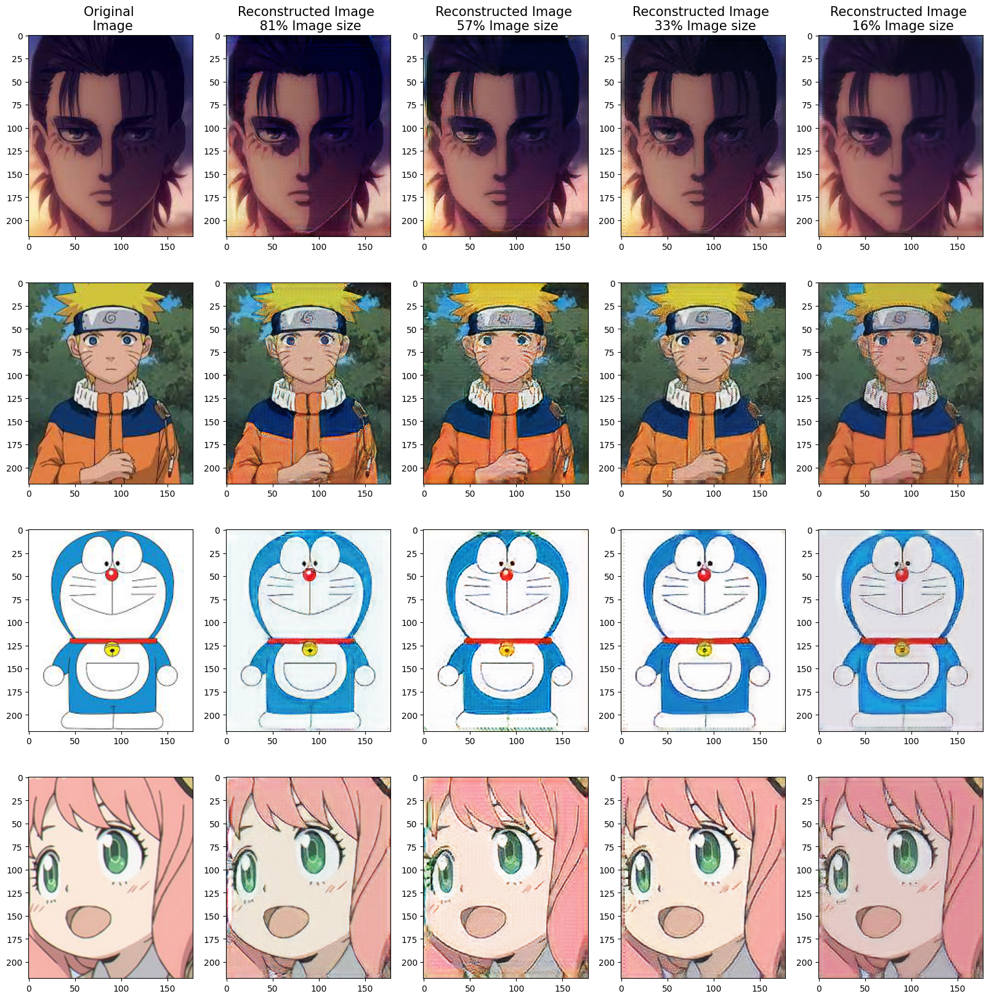

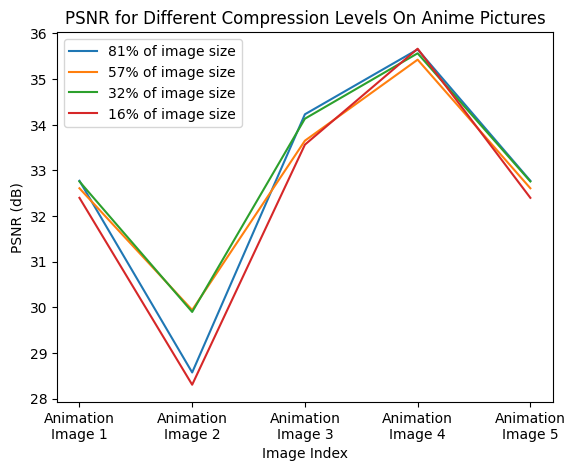

In [28]:
f, axarr = plt.subplots(4,5)

axarr[0,0].title.set_text('Original \n Image')
axarr[0,1].title.set_text('Reconstructed Image \n 81% Image size')
axarr[0,2].title.set_text('Reconstructed Image \n 57% Image size')
axarr[0,3].title.set_text('Reconstructed Image \n 33% Image size')
axarr[0,4].title.set_text('Reconstructed Image \n 16% Image size')

for i in range(5):
    axarr[0,i].title.set_fontsize(15)

for i in range(4):
    axarr[i,0].imshow(anime_batch[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,1].imshow(anime_40[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,2].imshow(anime_28[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,3].imshow(anime_16[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,4].imshow(anime_8[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    f.set_figheight(20)
    f.set_figwidth(20)
plt.show()

# x-axis values (e.g., image indices)
x = ['Animation'+'\n'+'Image 1', 'Animation'+'\n'+'Image 2', 'Animation'+'\n'+'Image 3', 'Animation'+'\n'+'Image 4', 'Animation'+'\n'+'Image 5']

# Plotting
plt.plot(x, psnr40[:5], label='81% of image size')
plt.plot(x, psnr28[:5], label='57% of image size')
plt.plot(x, psnr16[:5], label='32% of image size')
plt.plot(x, psnr8[:5], label='16% of image size')

# Set labels and title
plt.xlabel('Image Index')
plt.ylabel('PSNR (dB)')
plt.title('PSNR for Different Compression Levels On Anime Pictures')

# Display legend
plt.legend()

# Show the plot
plt.show()

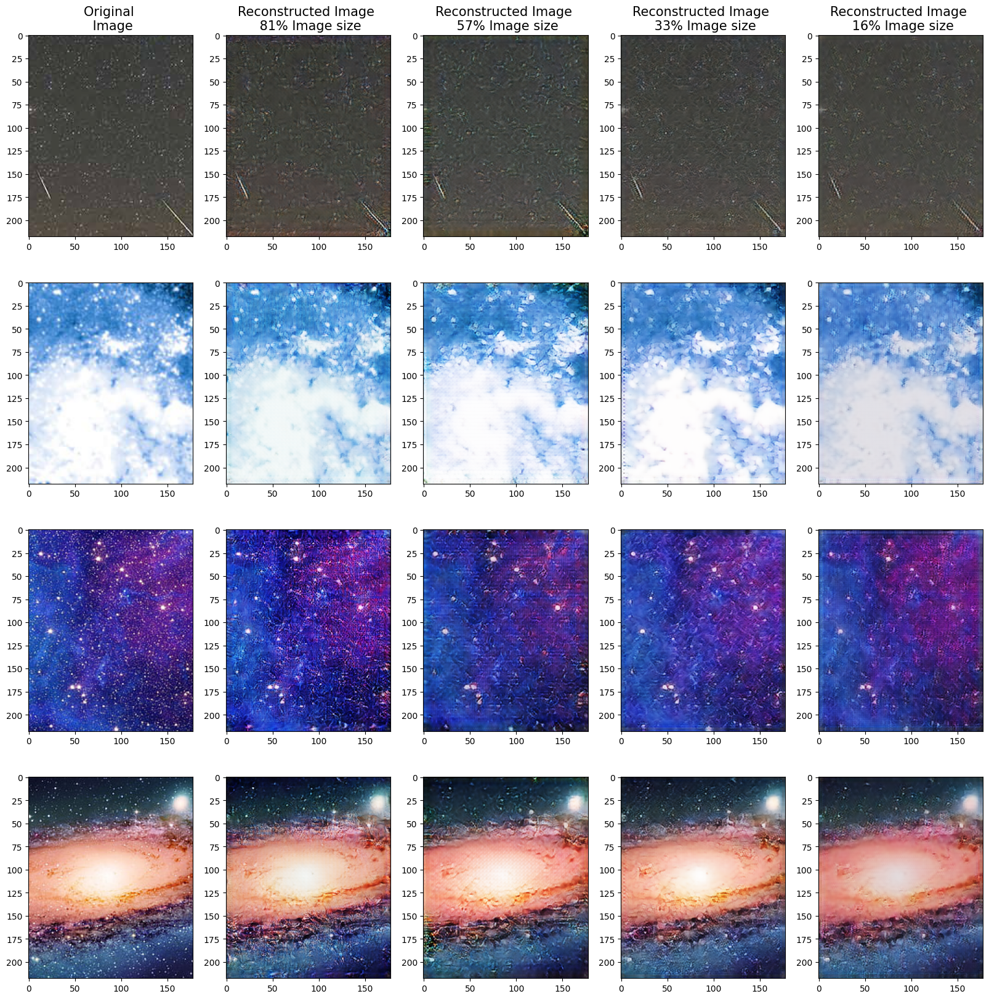

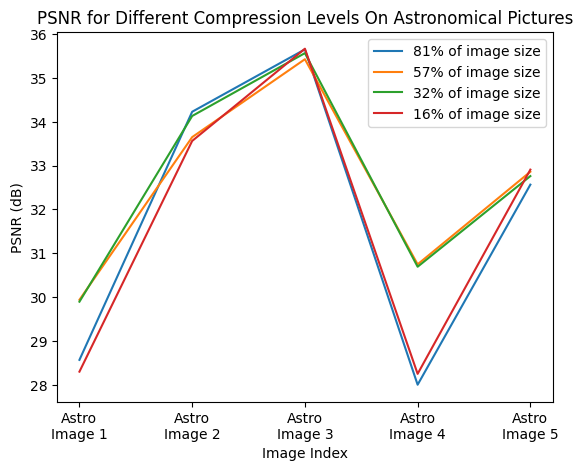

In [29]:
f, axarr = plt.subplots(4,5)

axarr[0,0].title.set_text('Original \n Image')
axarr[0,1].title.set_text('Reconstructed Image \n 81% Image size')
axarr[0,2].title.set_text('Reconstructed Image \n 57% Image size')
axarr[0,3].title.set_text('Reconstructed Image \n 33% Image size')
axarr[0,4].title.set_text('Reconstructed Image \n 16% Image size')

for i in range(5):
    axarr[0,i].title.set_fontsize(15)

for i in range(4):
    axarr[i,0].imshow(astro_batch[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,1].imshow(astro_40[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,2].imshow(astro_28[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,3].imshow(astro_16[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,4].imshow(astro_8[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    f.set_figheight(20)
    f.set_figwidth(20)
plt.show()

# x-axis values (e.g., image indices)
x = ['Astro'+'\n'+'Image 1', 'Astro'+'\n'+'Image 2', 'Astro'+'\n'+'Image 3', 'Astro'+'\n'+'Image 4', 'Astro'+'\n'+'Image 5']

# Plotting
plt.plot(x, psnr40[5:10], label='81% of image size')
plt.plot(x, psnr28[5:10], label='57% of image size')
plt.plot(x, psnr16[5:10], label='32% of image size')
plt.plot(x, psnr8[5:10], label='16% of image size')

# Set labels and title
plt.xlabel('Image Index')
plt.ylabel('PSNR (dB)')
plt.title('PSNR for Different Compression Levels On Astronomical Pictures')

# Display legend
plt.legend()

# Show the plot
plt.show()

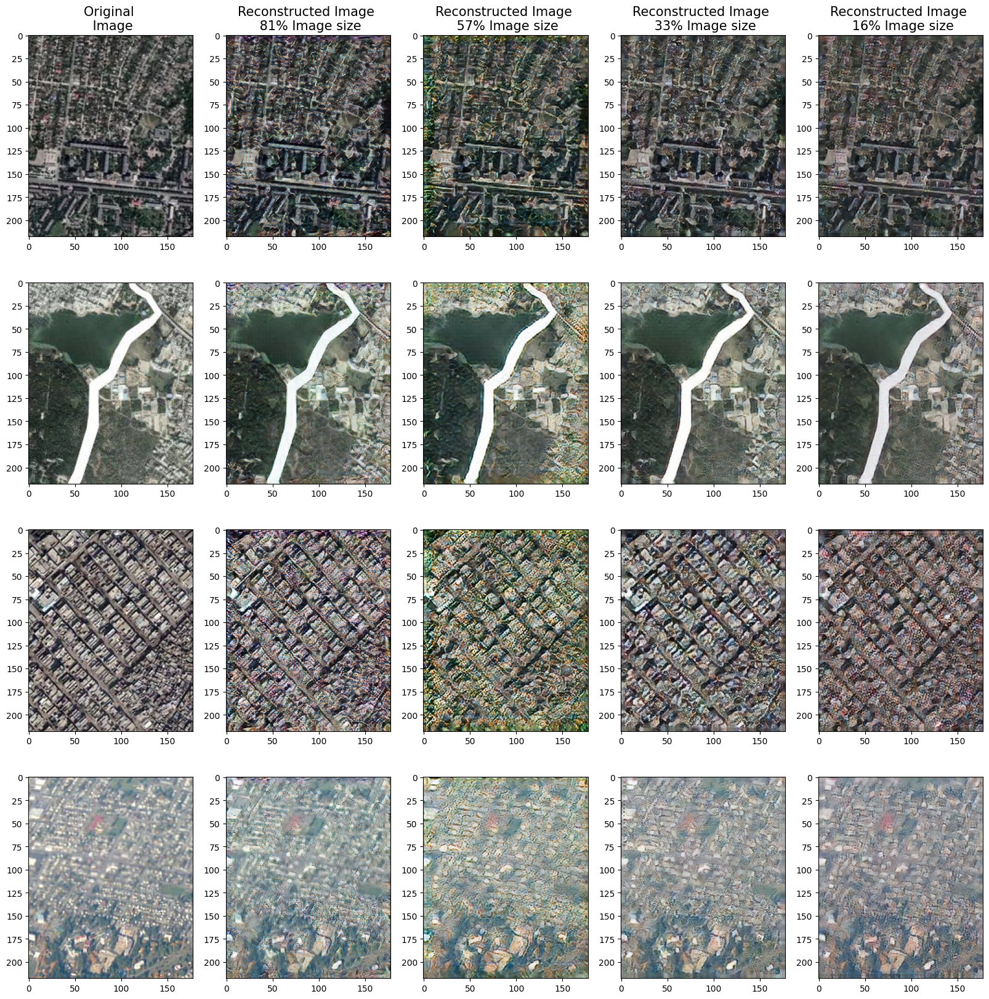

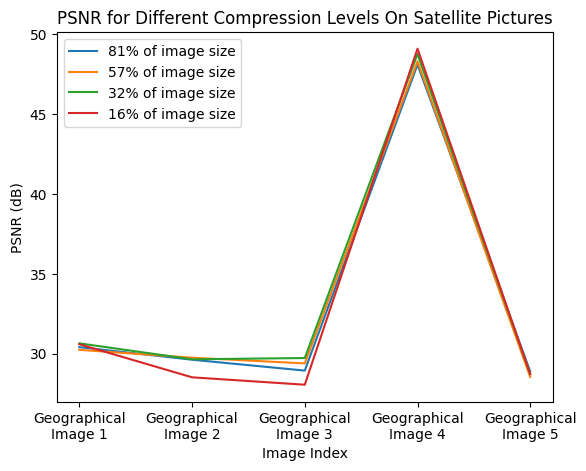

In [43]:
f, axarr = plt.subplots(4,5)

axarr[0,0].title.set_text('Original \n Image')
axarr[0,1].title.set_text('Reconstructed Image \n 81% Image size')
axarr[0,2].title.set_text('Reconstructed Image \n 57% Image size')
axarr[0,3].title.set_text('Reconstructed Image \n 33% Image size')
axarr[0,4].title.set_text('Reconstructed Image \n 16% Image size')

for i in range(5):
    axarr[0,i].title.set_fontsize(15)

for i in range(4):
    axarr[i,0].imshow(geo_batch[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,1].imshow(geo_40[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,2].imshow(geo_28[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,3].imshow(geo_16[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,4].imshow(geo_8[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    f.set_figheight(20)
    f.set_figwidth(20)
plt.show()

# x-axis values (e.g., image indices)
x = ['Geographical'+'\n'+'Image 1', 'Geographical'+'\n'+'Image 2', 'Geographical'+'\n'+'Image 3', 'Geographical'+'\n'+'Image 4', 'Geographical'+'\n'+'Image 5']

# Plotting
plt.plot(x, psnr40[10:15], label='81% of image size')
plt.plot(x, psnr28[10:15], label='57% of image size')
plt.plot(x, psnr16[10:15], label='32% of image size')
plt.plot(x, psnr8[10:15], label='16% of image size')

# Set labels and title
plt.xlabel('Image Index')
plt.ylabel('PSNR (dB)')
plt.title('PSNR for Different Compression Levels On Satellite Pictures')

# Display legend
plt.legend()

# Show the plot
plt.show()

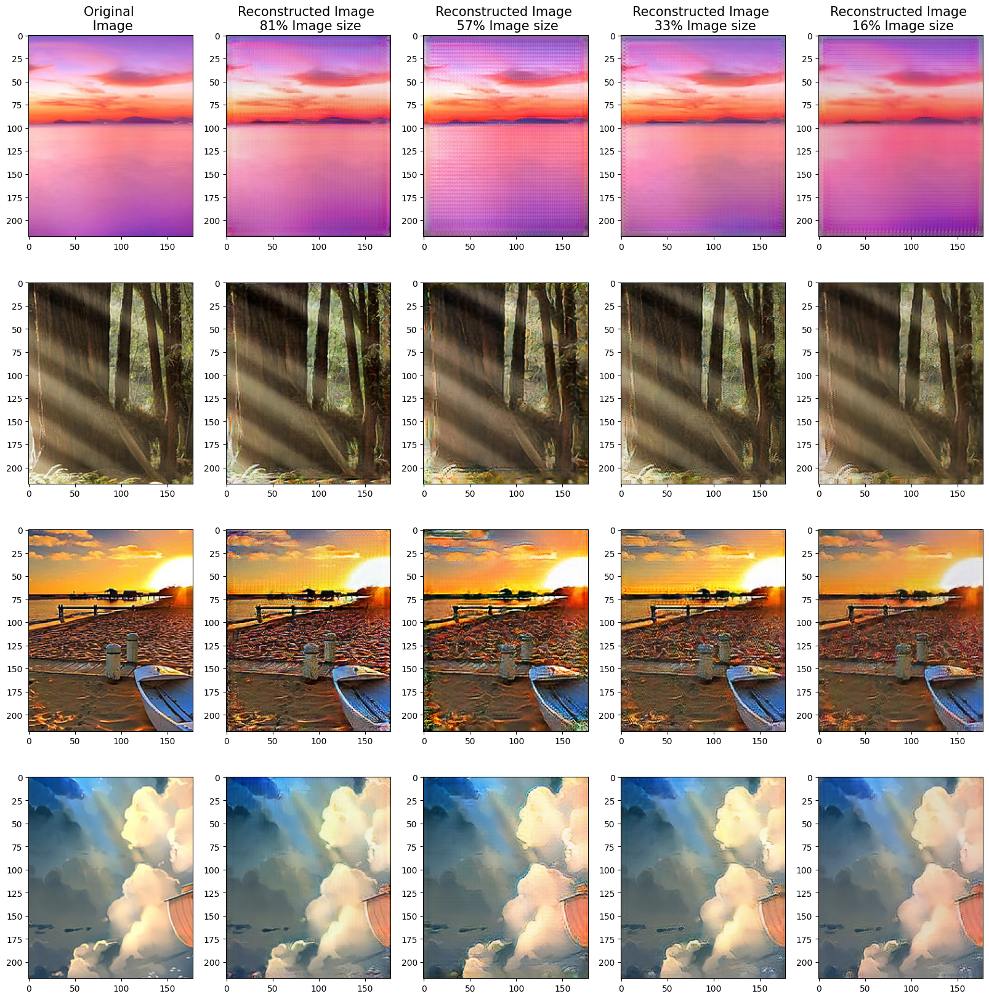

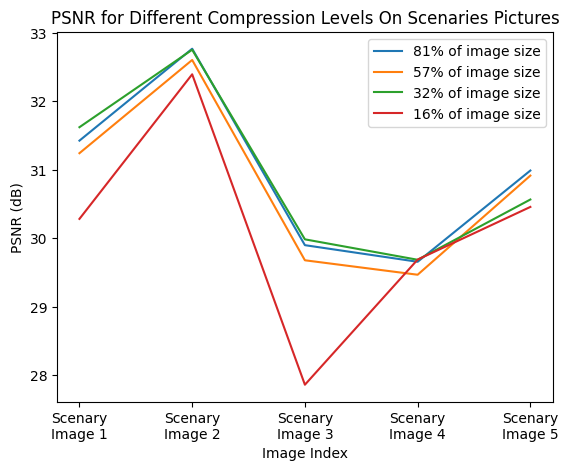

In [33]:
f, axarr = plt.subplots(4,5)

axarr[0,0].title.set_text('Original \n Image')
axarr[0,1].title.set_text('Reconstructed Image \n 81% Image size')
axarr[0,2].title.set_text('Reconstructed Image \n 57% Image size')
axarr[0,3].title.set_text('Reconstructed Image \n 33% Image size')
axarr[0,4].title.set_text('Reconstructed Image \n 16% Image size')

for i in range(5):
    axarr[0,i].title.set_fontsize(15)

for i in range(4):
    axarr[i,0].imshow(scenary_batch[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,1].imshow(scenary_40[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,2].imshow(scenary_28[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,3].imshow(scenary_16[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    axarr[i,4].imshow(scenary_8[i].cpu().detach().permute(1, 2, 0)*0.5+0.5)
    f.set_figheight(20)
    f.set_figwidth(20)
plt.show()

# x-axis values (e.g., image indices)
x = ['Scenary'+'\n'+'Image 1', 'Scenary'+'\n'+'Image 2', 'Scenary'+'\n'+'Image 3', 'Scenary'+'\n'+'Image 4', 'Scenary'+'\n'+'Image 5']

# Plotting
plt.plot(x, psnr40[15:20], label='81% of image size')
plt.plot(x, psnr28[15:20], label='57% of image size')
plt.plot(x, psnr16[15:20], label='32% of image size')
plt.plot(x, psnr8[15:20], label='16% of image size')

# Set labels and title
plt.xlabel('Image Index')
plt.ylabel('PSNR (dB)')
plt.title('PSNR for Different Compression Levels On Scenaries Pictures')

# Display legend
plt.legend()

# Show the plot
plt.show()

In [30]:
from collections import Counter

def highest_frequency_element(lst):
    # Count the frequency of each element in the list
    counts = Counter(lst)
    
    # Get the element(s) with the highest frequency
    highest_frequency = max(counts.values())
    highest_frequency_elements = [elem for elem, count in counts.items() if count == highest_frequency]
    return highest_frequency_elements[0]

In [31]:
def result(n):
  if n is 0: return '81%'
  if n is 1: return '57%'
  if n is 2: return '32%'
  if n is 3: return '16%'

In [32]:
#Computing which compression ratio is ideal
animeSup = []
astroSup = []
geoSup = []
scenerySup = []

for i in range(5):
  m1 = [psnr40[i], psnr28[i], psnr16[i], psnr8[i]]
  m2 = [psnr40[i+5], psnr28[i+5], psnr16[i+5], psnr8[i+5]]
  m3 = [psnr40[i+10], psnr28[i+10], psnr16[i+10], psnr8[i+10]]
  m4 = [psnr40[i+15], psnr28[i+15], psnr16[i+15], psnr8[i+15]]
  animeSup.append(m1.index(max(m1)))
  astroSup.append(m2.index(max(m2)))
  geoSup.append(m3.index(max(m3)))
  scenerySup.append(m4.index(max(m4)))

anime_sup=highest_frequency_element(animeSup)
astro_sup=highest_frequency_element(astroSup)
geo_sup=highest_frequency_element(geoSup)
scenary_sup=highest_frequency_element(scenerySup)
print("The Most suitable compression ratio for ANIME images for this model is:  "+result(anime_sup)+"  of Original image size")
print("The Most suitable compression ratio for ASTRONOMICAL images for this model is:  "+result(astro_sup)+"  of Original image size")
print("The Most suitable compression ratio for SATELLITE images for this model is:  "+result(geo_sup)+"  of Original image size")
print("The Most suitable compression ratio for SCENARY images for this model is:  "+result(scenary_sup)+"  of Original image size")

The Most suitable compression ratio for ANIME images for this model is:  81%  of Original image size
The Most suitable compression ratio for ASTRONOMICAL images for this model is:  57%  of Original image size
The Most suitable compression ratio for SATELLITE images for this model is:  32%  of Original image size
The Most suitable compression ratio for SCENARY images for this model is:  32%  of Original image size
